 **IMPORTING AND INSTALLING THE DEPENDENCIES AND THE DATASET**

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/musdb18ying/README.md
/kaggle/input/musdb18ying/test/Raft Monk - Tiring.stem.mp4
/kaggle/input/musdb18ying/test/BKS - Too Much.stem.mp4
/kaggle/input/musdb18ying/test/Georgia Wonder - Siren.stem.mp4
/kaggle/input/musdb18ying/test/The Sunshine Garcia Band - For I Am The Moon.stem.mp4
/kaggle/input/musdb18ying/test/Enda Reilly - Cur An Long Ag Seol.stem.mp4
/kaggle/input/musdb18ying/test/Buitraker - Revo X.stem.mp4
/kaggle/input/musdb18ying/test/We Fell From The Sky - Not You.stem.mp4
/kaggle/input/musdb18ying/test/The Mountaineering Club - Mallory.stem.mp4
/kaggle/input/musdb18ying/test/Skelpolu - Resurrection.stem.mp4
/kaggle/input/musdb18ying/test/Secretariat - Over The Top.stem.mp4
/kaggle/input/musdb18ying/test/James Elder  Mark M Thompson - The English Actor.stem.mp4
/kaggle/input/musdb18ying/test/Bobby Nobody - Stitch Up.stem.mp4
/kaggle/input/musdb18ying/test/Arise - Run Run Run.stem.mp4
/kaggle/input/musdb18ying/test/Carlos Gonzalez - A Place For Us.stem.mp4
/kaggl

In [2]:
pip install musdb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 963.5/963.5 kB 16.5 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [3]:
# https://github.com/sigsep/sigsep-mus-db 
import musdb
mus = musdb.DB(root="/kaggle/input/musdb18ying")
mus[0].audio

array([[1.47705078e-02, 3.02124023e-03],
       [3.26538086e-02, 1.63879395e-02],
       [5.39550781e-02, 3.79028320e-02],
       ...,
       [0.00000000e+00, 0.00000000e+00],
       [3.05175781e-05, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00]])

In [4]:
print(len(mus))
# mus.MUSDB_PATH = "/kaggle/input/musdb18ying"
mus_train = musdb.DB(root="/kaggle/input/musdb18ying",subsets="train")
print(len(mus_train))

150
100


**BREAKING THE AUDIO INTO CHUNKS OF 64 TIME STAMPS TO CREATE THE TRAIN SET (USED THE LEFT CHANNEL AUDIO)**

In [7]:
import pandas as pd

# create empty lists to store the data
x_list = []
y_list = []

# loop over each song in musdb
counter = 1 
for song in mus_train:
    print(counter)
    # get the left audio and drums data
    audio_data = song.targets['accompaniment'].audio.T[0]
    drums_data = song.targets['drums'].audio.T[0]
    
    # split the audio and drums data into 64-sample chunks
    audio_chunks = [audio_data[i:i+64] for i in range(0, len(audio_data),64)]#64
    drums_chunks = [drums_data[i:i+64] for i in range(0, len(drums_data),64)]

    # print(audio_chunks)
    # print(drums_chunks)
    # add the chunks to the x_list and y_list
    x_list.extend(audio_chunks)
    y_list.extend(drums_chunks)
    #
    
    if(counter==2) :
        break
    
    counter = counter+1    
        
# create the DataFrame with x and y as columns
df_train = pd.DataFrame({'x': x_list, 'y': y_list})

print(df_train.head())
print(df_train.shape)

1
2
                                                   x  \
0  [-0.001373291015625, 0.0078125, 0.016693115234...   
1  [0.023162841796875, 0.022552490234375, 0.02322...   
2  [0.009552001953125, 0.00592041015625, 0.004699...   
3  [0.023529052734375, 0.023712158203125, 0.01525...   
4  [0.027801513671875, 0.020751953125, 0.01266479...   

                                                   y  
0  [0.001373291015625, 0.002838134765625, 0.00265...  
1  [0.001617431640625, -0.0006103515625, -0.00350...  
2  [-0.011749267578125, -0.012969970703125, -0.01...  
3  [0.004180908203125, 0.0048828125, 0.0039672851...  
4  [0.0120849609375, 0.01171875, 0.01171875, 0.01...  
(281904, 2)


**BREAKING THE AUDIO INTO CHUNKS OF 64 TIME STAMPS TO CREATE THE VAL SET (USED THE RIGHT CHANNEL AUDIO)**

In [8]:
import pandas as pd

# create empty lists to store the data
x_list = []
y_list = []

# loop over each song in musdb
counter = 1 
for song in mus_train:
    print(counter)
    # get the right audio and drums data
    audio_data = song.targets['accompaniment'].audio.T[1]
    drums_data = song.targets['drums'].audio.T[1]
    
    # split the audio and drums data into 64-sample chunks
    audio_chunks = [audio_data[i:i+64] for i in range(0, len(audio_data),64)]#64
    drums_chunks = [drums_data[i:i+64] for i in range(0, len(drums_data),64)]

    # print(audio_chunks)
    # print(drums_chunks)
    # add the chunks to the x_list and y_list
    x_list.extend(audio_chunks)
    y_list.extend(drums_chunks)
    #
    if(counter==2) :
        break
    counter = counter+1
        
# create the DataFrame with x and y as columns
df_test = pd.DataFrame({'x': x_list, 'y': y_list})

print(df_test.head())
print(df_test.shape)

1
2
                                                   x  \
0  [-0.00531005859375, -0.001190185546875, 0.0037...   
1  [0.027587890625, 0.022216796875, 0.01687622070...   
2  [0.007965087890625, 0.0020751953125, -0.001647...   
3  [0.040435791015625, 0.03961181640625, 0.030548...   
4  [-0.009429931640625, -0.013580322265625, -0.01...   

                                                   y  
0  [0.001220703125, 0.002227783203125, 0.00234985...  
1  [0.00341796875, 0.00152587890625, -0.001861572...  
2  [-0.011749267578125, -0.013519287109375, -0.01...  
3  [0.004791259765625, 0.005828857421875, 0.00500...  
4  [0.01300048828125, 0.012542724609375, 0.012481...  
(281904, 2)


**CONSTRUCTING THE UNET MODEL**

In [9]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, UpSampling1D, Concatenate
kernel_size = 5
strides = 1


input_layer = tf.keras.layers.Input(shape=(None,64))

conv1 = tf.keras.layers.Conv1D(filters=16, kernel_size=kernel_size, strides=strides, padding='same')(input_layer)
batch1 = tf.keras.layers.BatchNormalization()(conv1)
activ1 = tf.keras.layers.LeakyReLU(alpha=0.2)(batch1)

conv2 = tf.keras.layers.Conv1D(filters=32, kernel_size=kernel_size, strides=strides, padding='same')(activ1)
batch2 = tf.keras.layers.BatchNormalization()(conv2)
activ2 = tf.keras.layers.LeakyReLU(alpha=0.2)(batch2)

conv3 = tf.keras.layers.Conv1D(filters=64, kernel_size=kernel_size, strides=strides, padding='same')(activ2)
batch3 = tf.keras.layers.BatchNormalization()(conv3)
activ3 = tf.keras.layers.LeakyReLU(alpha=0.2)(batch3)

conv4 = tf.keras.layers.Conv1D(filters=128, kernel_size=kernel_size, strides=strides, padding='same')(activ3)
batch4 = tf.keras.layers.BatchNormalization()(conv4)
activ4 = tf.keras.layers.LeakyReLU(alpha=0.2)(batch4)

conv5 = tf.keras.layers.Conv1D(filters=256, kernel_size=kernel_size, strides=strides, padding='same')(activ4)
batch5 = tf.keras.layers.BatchNormalization()(conv5)
activ5 = tf.keras.layers.LeakyReLU(alpha=0.2)(batch5)

conv6 = tf.keras.layers.Conv1D(filters=512, kernel_size=kernel_size, strides=strides, padding='same')(activ5)
batch6 = tf.keras.layers.BatchNormalization()(conv6)
activ6 = tf.keras.layers.LeakyReLU(alpha=0.2)(batch6)

up5 = tf.keras.layers.Conv1DTranspose(filters=256, kernel_size=kernel_size, strides=strides, padding='same')(activ6)
conc5 = tf.keras.layers.Concatenate()([up5, activ5])
uactiv5 = tf.keras.layers.ReLU()(conc5)
drop1 = tf.keras.layers.Dropout(0.5)(uactiv5)

up4 = tf.keras.layers.Conv1DTranspose(filters=128, kernel_size=kernel_size, strides=strides, padding='same')(drop1)
conc4 = tf.keras.layers.Concatenate()([up4, activ4])
uactiv4 = tf.keras.layers.ReLU()(conc4)
conc4 = tf.keras.layers.Dropout(0.5)(uactiv4)

up3 = tf.keras.layers.Conv1DTranspose(filters=64, kernel_size=kernel_size, strides=strides, padding='same')(conc4)
conc3 = tf.keras.layers.Concatenate()([up3, activ3])
uactiv3 = tf.keras.layers.ReLU()(conc3)
drop3 = tf.keras.layers.Dropout(0.5)(uactiv3)

up2 = tf.keras.layers.Conv1DTranspose(filters=32, kernel_size=kernel_size, strides=strides, padding='same')(drop3)
conc2 = tf.keras.layers.Concatenate()([up2, activ2])
uactiv2 = tf.keras.layers.ReLU()(conc2)

up1 = tf.keras.layers.Conv1DTranspose(filters=16, kernel_size=kernel_size, strides=strides, padding='same')(uactiv2)
conc1 = tf.keras.layers.Concatenate()([up1, activ1])
uactiv1 = tf.keras.layers.ReLU()(conc1)

mask = tf.keras.layers.Conv1DTranspose(filters=1, kernel_size=kernel_size, strides=strides, padding='same')(uactiv1)
output_layer = tf.keras.layers.Multiply()([input_layer, mask])

model = tf.keras.Model(inputs=input_layer, outputs=output_layer)

model.summary()

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, 64)]   0           []                               
                                                                                                  
 conv1d (Conv1D)                (None, None, 16)     5136        ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, None, 16)    64          ['conv1d[0][0]']                 
 alization)                                                                                       
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, None, 16)     0           ['batch_normalization[0][0]']

**TRAINING THE MODEL**

In [10]:
from tqdm.keras import TqdmCallback
model.compile(
    loss=['mae'],
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
)
x_train = tf.expand_dims((tf.constant(df_train['x'].apply(lambda x: list(x)).tolist())),0)
y_train = tf.expand_dims((tf.constant(df_train['y'].tolist())),0)
x_val = tf.expand_dims(tf.constant(df_test['x'].apply(lambda x: list(x)).tolist()),0)
y_val = tf.expand_dims(tf.constant(df_test['y'].tolist()),0)

history = model.fit(x_train, y_train, epochs=40, validation_data=(x_val, y_val), verbose=2, callbacks=[TqdmCallback(verbose=2)])

0epoch [00:00, ?epoch/s]

  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 1/40
1/1 - 26s - loss: 0.0860 - val_loss: 0.0236 - 26s/epoch - 26s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 2/40
1/1 - 2s - loss: 0.0663 - val_loss: 0.0230 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 3/40
1/1 - 2s - loss: 0.0543 - val_loss: 0.0228 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 4/40
1/1 - 2s - loss: 0.0499 - val_loss: 0.0224 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 5/40
1/1 - 2s - loss: 0.0459 - val_loss: 0.0221 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 6/40
1/1 - 2s - loss: 0.0426 - val_loss: 0.0218 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 7/40
1/1 - 2s - loss: 0.0402 - val_loss: 0.0218 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 8/40
1/1 - 2s - loss: 0.0384 - val_loss: 0.0218 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 9/40
1/1 - 2s - loss: 0.0367 - val_loss: 0.0218 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 10/40
1/1 - 2s - loss: 0.0354 - val_loss: 0.0218 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 11/40
1/1 - 2s - loss: 0.0343 - val_loss: 0.0217 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 12/40
1/1 - 2s - loss: 0.0332 - val_loss: 0.0215 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 13/40
1/1 - 2s - loss: 0.0323 - val_loss: 0.0214 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 14/40
1/1 - 2s - loss: 0.0316 - val_loss: 0.0213 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 15/40
1/1 - 2s - loss: 0.0310 - val_loss: 0.0213 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 16/40
1/1 - 2s - loss: 0.0305 - val_loss: 0.0214 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 17/40
1/1 - 2s - loss: 0.0298 - val_loss: 0.0215 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 18/40
1/1 - 2s - loss: 0.0293 - val_loss: 0.0215 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 19/40
1/1 - 2s - loss: 0.0289 - val_loss: 0.0215 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 20/40
1/1 - 2s - loss: 0.0285 - val_loss: 0.0214 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 21/40
1/1 - 2s - loss: 0.0281 - val_loss: 0.0213 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 22/40
1/1 - 2s - loss: 0.0276 - val_loss: 0.0212 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 23/40
1/1 - 2s - loss: 0.0273 - val_loss: 0.0212 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 24/40
1/1 - 2s - loss: 0.0269 - val_loss: 0.0212 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 25/40
1/1 - 2s - loss: 0.0266 - val_loss: 0.0212 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 26/40
1/1 - 2s - loss: 0.0263 - val_loss: 0.0212 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 27/40
1/1 - 2s - loss: 0.0260 - val_loss: 0.0212 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 28/40
1/1 - 2s - loss: 0.0258 - val_loss: 0.0212 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 29/40
1/1 - 2s - loss: 0.0255 - val_loss: 0.0211 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 30/40
1/1 - 2s - loss: 0.0253 - val_loss: 0.0211 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 31/40
1/1 - 2s - loss: 0.0250 - val_loss: 0.0211 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 32/40
1/1 - 2s - loss: 0.0248 - val_loss: 0.0211 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 33/40
1/1 - 2s - loss: 0.0246 - val_loss: 0.0211 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 34/40
1/1 - 2s - loss: 0.0244 - val_loss: 0.0211 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 35/40
1/1 - 2s - loss: 0.0242 - val_loss: 0.0210 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 36/40
1/1 - 2s - loss: 0.0240 - val_loss: 0.0210 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 37/40
1/1 - 2s - loss: 0.0238 - val_loss: 0.0210 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 38/40
1/1 - 2s - loss: 0.0236 - val_loss: 0.0210 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 39/40
1/1 - 2s - loss: 0.0235 - val_loss: 0.0210 - 2s/epoch - 2s/step


  0%|          | 0.00/1.00 [00:00<?, ?batch/s]

Epoch 40/40
1/1 - 2s - loss: 0.0233 - val_loss: 0.0209 - 2s/epoch - 2s/step


**SAVING THE MODEL**

In [11]:
model.save(f'models/unet.h5')
model.save_weights('model_weights.h5')
print("Weights are saved")
model.load_weights('model_weights.h5')

Weights are saved


**PLOTTING THE TRAIN LOSS AND VAL LOSS**

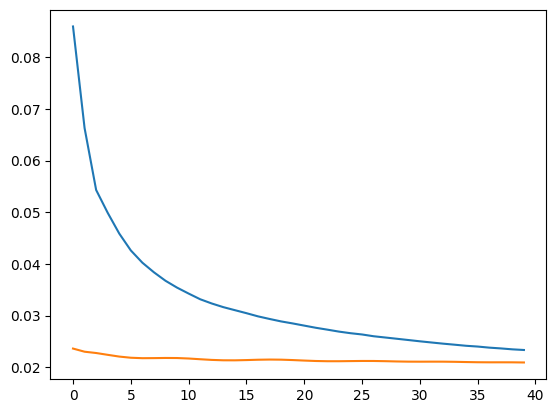

In [12]:
from matplotlib import pyplot as plt
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])

**TESTING THE MODEL**

In [13]:
mus_test = musdb.DB(root="/kaggle/input/musdb18ying",subsets="test")
print(len(mus_test))
mus_test[11].audio

50


array([[ 0.00073242, -0.02859497],
       [ 0.00198364, -0.03573608],
       [ 0.00292969, -0.03018188],
       ...,
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ],
       [ 0.        ,  0.        ]])

**USING THE LEFT CHANNEL DATA FOR TESTING AND FINDING THE ACCURACY**

In [14]:
id = 11

x_list1 = []
y_list1 = []

   
# get the left audio and drums data
audio_data = mus_test[id].targets['accompaniment'].audio.T[0]
drums_data = mus_test[id].targets['drums'].audio.T[0]
    
# split the audio and vocals data into 64-sample chunks
audio_chunks = [audio_data[i:i+64] for i in range(0, len(audio_data),64)]#64
drums_chunks = [drums_data[i:i+64] for i in range(0, len(drums_data),64)]

    
# add the chunks to the x_list and y_list
x_list1.extend(audio_chunks)
y_list1.extend(drums_chunks)

# create the DataFrame with x and y as columns
df_pred = pd.DataFrame({'x': x_list1, 'y': y_list1}) 
x_test = tf.expand_dims((tf.constant(df_pred['x'].apply(lambda x: list(x)).tolist())),0)
y_test = tf.expand_dims((tf.constant(df_pred['y'].tolist())),0)
y_pred = model.predict(x_test)


def calculate_snr(true_signal, predicted_signal):
    noise = true_signal - predicted_signal
    signal_power = np.sum(true_signal ** 2)
    noise_power = np.sum(noise ** 2)
    snr = 10 * np.log10(signal_power / noise_power)
    return snr

# Calculate the SNR between the true and predicted signals
accuracy = calculate_snr(y_test, y_pred)

print("Accuracy (SNR):", abs(accuracy))
df_pred



1/1 [==============================] - 2s 2s/step
Accuracy (SNR): 0.0027806228684685566


,x,y
0,"[0.000732421875, 0.001983642578125, 0.00292968...","[0.000732421875, 0.001983642578125, 0.00292968..."
1,"[-0.035919189453125, -0.034515380859375, -0.03...","[-0.035919189453125, -0.034515380859375, -0.03..."
2,"[0.016845703125, 0.0184326171875, 0.0199890136...","[0.016845703125, 0.0184326171875, 0.0199890136..."
3,"[0.00775146484375, 0.0081787109375, 0.00823974...","[0.00775146484375, 0.0081787109375, 0.00823974..."
4,"[-0.007843017578125, -0.0072021484375, -0.0062...","[-0.007843017578125, -0.0072021484375, -0.0062..."
...,...,...
131115,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
131116,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
131117,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
131118,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


**FINAL DRUM SEPARATED OUTPUT**

In [15]:
from IPython.display import Audio

# Assuming you have the arrays y_test and y_pred containing the audio data
y_pred1 = y_pred.flatten()
# Play the true signal (y_test)
numpy_array = y_test.numpy()

# Convert the NumPy array to a 1D array
numpy_1d_array = numpy_array.flatten()
# Audio(numpy_1d_array, rate=44100)

# Play the predicted signal (y_pred)
Audio(y_pred1, rate=44100)